In [1]:
import torch
from torch import nn, optim, tensor, Tensor
from torchdiffeq import odeint, odeint_adjoint
from torchdyn.datasets import ToyDataset
import matplotlib.pyplot as plt
from matplotlib import animation
import progressbar

1. Generate the dataset - a distribution we want to transfer it into standard normal distribution.

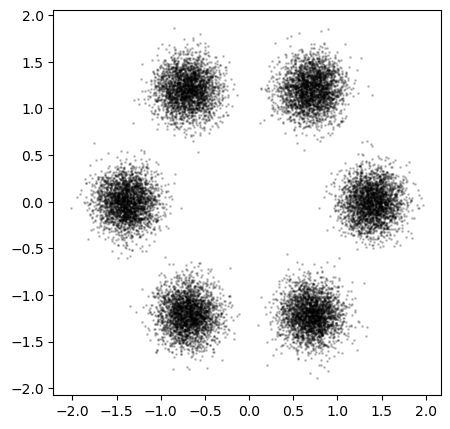

In [25]:
n_samples = 2 ** 14 # the number of samples
n_gaussians = 6 # the number of Gaussians

X, _ = ToyDataset().generate(n_samples // n_gaussians, 
                              'gaussians', 
                              n_gaussians=n_gaussians, 
                              std_gaussians=.5,
                              radius=4,dim=2)


X = (X - X.mean()) / X.std()

plt.figure(figsize=(5, 5))
plt.scatter(X[:,0], X[:,1], c='black', alpha=0.2, s=1.)


In [3]:
X.size()

torch.Size([16380, 2])

2. According to the conclusion of Zhang et. al.
    $$ \begin{cases} \partial_{t}\begin{bmatrix} \mathbf{z}(\mathbf{x},t) \\ \ell(\mathbf{x},t) \end{bmatrix} = \begin{bmatrix} \mathbf{v}(\mathbf{z}(\mathbf{x},t), t;\boldsymbol{\theta}) \\ \text{tr}(\nabla \mathbf{v}(\mathbf{z}(\mathbf{x},t), t;\boldsymbol{\theta})) \end{bmatrix} \\ \begin{bmatrix} \mathbf{z}(\mathbf{x},t) \\ \ell(\mathbf{x},t) \end{bmatrix} =  \begin{bmatrix} \mathbf{x} \\ 0 \end{bmatrix} \end{cases} $$
    where $\nabla \mathbf{v}(\mathbf{z}(\mathbf{x},t),t;\boldsymbol{\theta})$ is the Jacobian Matrix: given that the input is $\mathbf{x}_{\text{in}}$ and the output is $\mathbf{x}_{\text{out}}$. therefore, we have:
    $$
    \mathbf{x}_{\text{out}} = \mathbf{x}_{\text{in}} + \int_{0}^{t'} \mathbf{v}(\mathbf{z}(\mathbf{x},t),t;\boldsymbol{\theta}) \,dt
    $$
    - We use continuous Planar Flow


In [2]:
def autograd_trace(x_out, x_in):
    """
    `autograd_trace`:(`x_out`, `x_in`): compute the trace of the Jacobian of `x_out` w.r.t. `x_in` using autograd.
    """
    trJ = 0.
    for i in range(x_in.shape[1]):
        trJ += torch.autograd.grad(x_out[:,i].sum(), x_in, create_graph=True)[0].contiguous()[:,i].contiguous()
    return trJ.contiguous()

In [3]:
class CNF(nn.Module):
    def __init__(self, in_out_dim, hidden_dim, width):
        super().__init__()
        self.in_out_dim = in_out_dim
        self.hidden_dim = hidden_dim
        self.width = width
        self.planar = Planar(in_out_dim, hidden_dim, width)

    def forward(self, t, states):
        z = states[0]
        logp_z = states[1]

        batchsize = z.shape[0]

        with torch.set_grad_enabled(True):
            z.requires_grad_(True)

            w,u,b = self.planar(t)

            Z = torch.unsqueeze(z,0).repeat(self.width, 1,1)

            h = torch.tanh(torch.matmul(Z,w) + b)
            dz_dt = torch.matmul(h, u).mean(0)

            dlogp_z_dt = -autograd_trace(dz_dt, z).view(batchsize, 1)
        
        return (dz_dt, dlogp_z_dt)

In [4]:
class Planar(nn.Module):
    """
    Construct a net according to the Planar Flow: return the params of the flow:
    u, w, b
    """
    def __init__(self, in_out_dim, hidden_dim, width):
        super().__init__()

        blocksize = width * in_out_dim

        self.fc1 = nn.Linear(1, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc3 = nn.Linear(hidden_dim, 3 * blocksize + width)

        self.in_out_dim = in_out_dim
        self.hidden_dim = hidden_dim
        self.width = width
        self.blocksize = blocksize
    
    def forward(self, t):
        params = t.reshape(1,1)
        params = torch.tanh(self.fc1(params))
        params = torch.tanh(self.fc2(params))
        params = self.fc3(params)
        params = params.reshape(-1)

        w = params[:self.blocksize].reshape(self.width, self.in_out_dim, 1)
        u = params[self.blocksize:2*self.blocksize].reshape(self.width, 1,self.in_out_dim)
        g = params[2*self.blocksize:3*self.blocksize].reshape(self.width, 1,self.in_out_dim)
        u = u*torch.sigmoid(g)

        b = params[3 * self.blocksize:].reshape(self.width,1,1)
        return [w,u,b]





In [9]:
n_gaussians = 6
def get_batch(num_samples):
    points, _ = ToyDataset().generate(num_samples // n_gaussians, 
                                'gaussians', 
                                n_gaussians=n_gaussians, 
                                std_gaussians=.5,
                                radius=4,dim=2)
    X = ((points - points.mean()) / points.std()).type(torch.float32).to(device)
    logp_diff_t1 = torch.zeros(num_samples, 1).type(torch.float32).to(device)

    return (X,logp_diff_t1)



In [5]:
t0 = 0
t1 = 10
device = torch.device(
    'cuda' if torch.cuda.is_available() else 'cpu'
)

func = CNF(in_out_dim=2, hidden_dim=20, width=3).to(device)
optimizer = optim.Adam(func.parameters(), lr=0.1)
p_z0 = torch.distributions.MultivariateNormal(
    loc=torch.tensor([0.0, 0.0]).to(device),
    covariance_matrix=torch.tensor([[1, 0.0], [0.0, 1]]).to(device)
)



In [31]:
check_point = torch.load('../six-gaussians.pt')
func.load_state_dict(check_point['model_state_dict'])
func.eval()


vis_sample = 1000
z0_vis = p_z0.sample([vis_sample])
logp_z0_vis = torch.zeros(vis_sample).to(device)

z1_vis, _ = odeint(
    func,
    (z0_vis, logp_z0_vis),
    torch.linspace(t0,t1,1000).float().to(device),
    atol = 1e-5,
    rtol = 1e-5,
    method = 'dopri5')



In [32]:
def anim(i):
    ax.cla()
    ax.set_xlim(-2,2)
    ax.set_ylim(-2,2)
    ax.scatter(X[:,0], X[:,1], c='black', alpha=0.2, s=3.)
    ax.scatter(*z1_vis[i].detach().cpu().T, c='red', alpha=0.8, s=3.)


MovieWriter imagemagick unavailable; using Pillow instead.


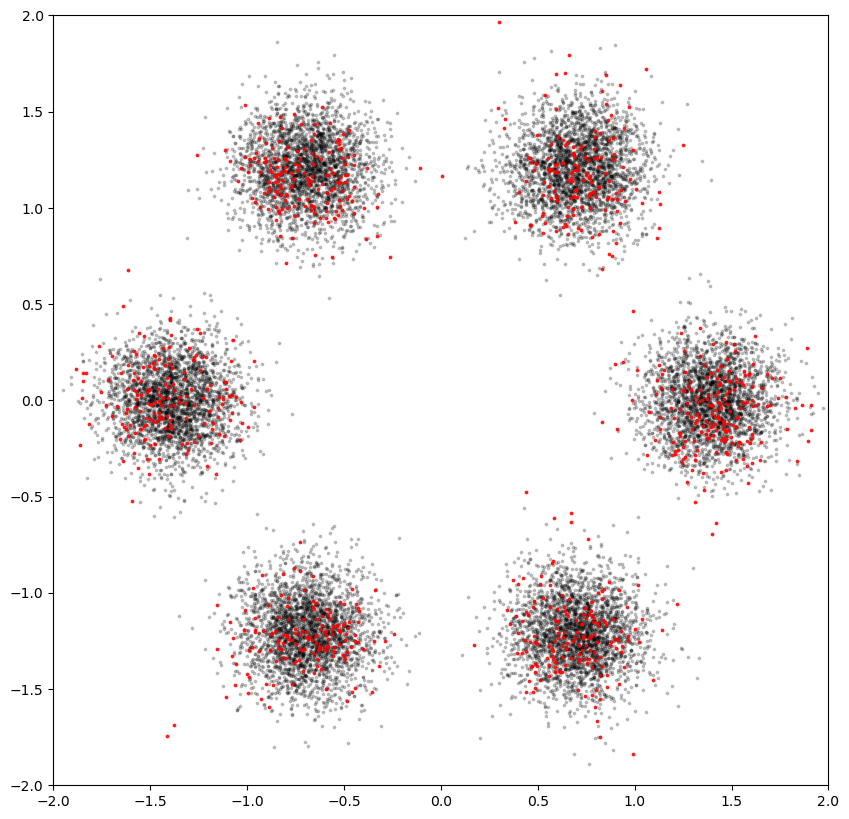

In [36]:
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111)
ax.set_xlim(-2,2)
ax.set_ylim(-2,2)
ani = animation.FuncAnimation(fig, anim, frames=1000, interval=100, repeat=False)
ani.save('a.gif', writer='imagemagick', fps=30)
plt.show()

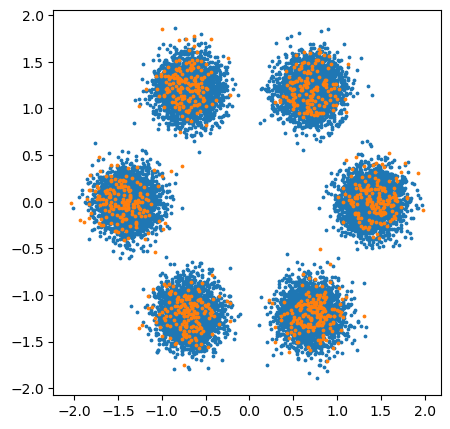

In [28]:
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(111)
ax.scatter(*X.detach().cpu().T, s=3.)
ax.scatter(*z1_vis[-1].detach().cpu().T, s=3.)

In [50]:
six_gaussians = torch.load('./six-gaussians.pt')
six_gaussians.eval()

CNF(
  (planar): Planar(
    (fc1): Linear(in_features=1, out_features=20, bias=True)
    (fc2): Linear(in_features=20, out_features=20, bias=True)
    (fc3): Linear(in_features=20, out_features=21, bias=True)
  )
)

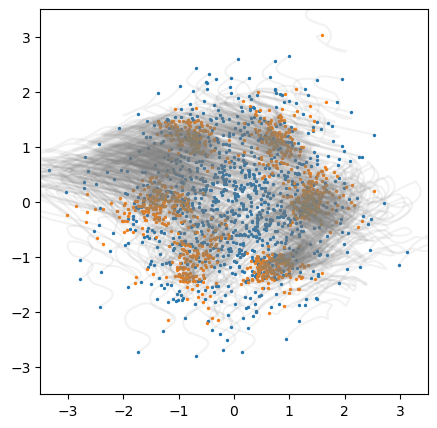

In [98]:
z0_vis = p_z0.sample([1000])
logp_z0_vis = torch.zeros(1000).type(torch.float32).to(device)
z1_vis = odeint(
    func,
    (z0_vis, logp_z0_vis), 
    torch.linspace(t0,t1,1000).type(torch.float32).to(device), 
    atol = 1e-5,
    rtol = 1e-5,
    method='dopri5')[0]

fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(111)
ax.set_xlim(-3.5,3.5)
ax.set_ylim(-3.5,3.5)

# ax.scatter(*X.detach().cpu().T, s= 1.)
for i in range(z1_vis.size()[1]):
    z1_vis[:,i,:]
    ax.plot(*z1_vis[:,i,:].detach().cpu().T, alpha=0.1, color="gray")
ax.scatter(*z0_vis.detach().cpu().squeeze().T, s=2.)
ax.scatter(*z1_vis[-1].detach().cpu().T, s=2.)

In [104]:
import pandas as pd
df = pd.DataFrame(columns=["itr", "loss"])

In [48]:
for itr in progressbar.progressbar(range(1, 2000+1)):
    optimizer.zero_grad()
    
    x, logp_diff_t1 = get_batch(6000)
    z_t, logp_diff_t = odeint(
                func,
                (x, logp_diff_t1),
                torch.tensor([t1, t0]).type(torch.float32).to(device),
                atol=1e-5,
                rtol=1e-5,
                method='dopri5',
            )
    z_t0, logp_diff_t0 = z_t[-1], logp_diff_t[-1]

    # logp_x = p_z0.log_prob(z_t0).to(device) - logp_diff_t0.view(-1)
    # loss = -logp_x.mean(0)
    C = 1/2 * z_t0.norm(dim=1,p=2) ** 2 + logp_diff_t0.view(-1) + torch.log(Tensor([2 * torch.pi]).to(device))
    loss = C.mean(0)


    loss.backward()
    optimizer.step()
    df.loc[len(df.index)] = [itr, loss.item()] 

    # print(loss.item())

  0% (0 of 2000) |                       | Elapsed Time: 0:00:00 ETA:  --:--:--
  0% (1 of 2000) |                       | Elapsed Time: 0:00:01 ETA:   1:01:07
  0% (2 of 2000) |                       | Elapsed Time: 0:00:03 ETA:   1:01:15
  0% (3 of 2000) |                       | Elapsed Time: 0:00:05 ETA:   1:01:04
  0% (4 of 2000) |                       | Elapsed Time: 0:00:07 ETA:   1:00:01
  0% (5 of 2000) |                       | Elapsed Time: 0:00:09 ETA:   1:01:20
  0% (6 of 2000) |                       | Elapsed Time: 0:00:11 ETA:   1:03:58
  0% (7 of 2000) |                       | Elapsed Time: 0:00:13 ETA:   1:03:13
  0% (8 of 2000) |                       | Elapsed Time: 0:00:15 ETA:   1:03:57
  0% (9 of 2000) |                       | Elapsed Time: 0:00:17 ETA:   1:03:41
  0% (10 of 2000) |                      | Elapsed Time: 0:00:19 ETA:   1:04:18
  0% (11 of 2000) |                      | Elapsed Time: 0:00:21 ETA:   1:05:19
  0% (12 of 2000) |                     

KeyboardInterrupt: 

In [23]:
t_pz0 = p_z0.sample([1000])
logp_diff_t0 = torch.zeros(1000, 1).type(torch.float32).to(device)


t_pz1 = odeint(
    func,
    (t_pz0, logp_diff_t0), 
    torch.linspace(t0,t1,1000).type(torch.float32).to(device),
    atol=1e-5,
    rtol=1e-5,
    )[0]


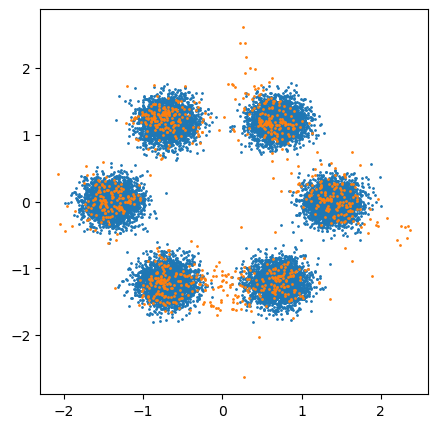

In [30]:
plt.figure(figsize=(5, 5))
plt.scatter(*X.T,s = 1.)
plt.scatter(*t_pz1[-1].detach().cpu().T, s = 1.)

In [108]:
torch.save(func, "./six-gaussians.pt")

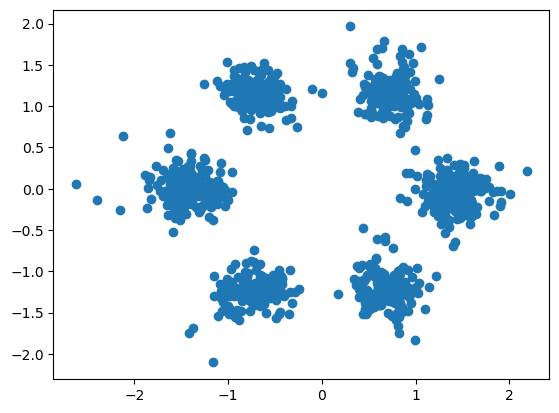

In [35]:
t_load = torch.load("./six-gaussians.pt")



t_pz0 = p_z0.sample([1000])
logp_diff_t0 = torch.zeros(1000, 1).type(torch.float32).to(device)


t_pz1 = odeint(
    t_load,
    (t_pz0, logp_diff_t0), 
    torch.linspace(t0,t1,1000).type(torch.float32).to(device),
    atol=1e-5,
    rtol=1e-5,
    )[0]

plt.scatter(*t_pz1[-1].detach().cpu().T)

MovieWriter imagemagick unavailable; using Pillow instead.


IndexError: list index out of range

Error in callback <function _draw_all_if_interactive at 0x7faf9d904360> (for post_execute):


NameError: name 't_pz1' is not defined

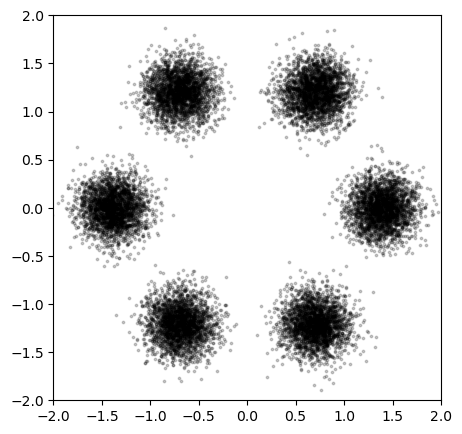

In [34]:
def anim(i):
    ax.cla()
    ax.set_xlim(-2,2)
    ax.set_ylim(-2,2)
    ax.scatter(X[:,0], X[:,1], c='black', alpha=0.2, s=3.)
    ax.scatter(*t_pz1[i].detach().cpu().T, c='red', alpha=0.8, s=3.)


fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111)
ax.set_xlim(-2,2)
ax.set_ylim(-2,2)
ani = animation.FuncAnimation(fig, anim, frames=1000, interval=100, repeat=False)
ani.save('a.gif', writer='imagemagick', fps=30)
plt.show()

In [94]:
for i in range(t_pz1.size()[0]):
    print(*t_pz1[i].detach().cpu().T)

tensor([ 1.5754e-01,  1.1392e-01,  4.2457e-02,  4.5887e-01,  1.3644e-01,
        -4.4919e-01,  1.9770e-01, -8.6772e-02,  3.7582e-03, -7.7114e-02,
         1.0712e-01,  1.2989e-01,  2.9710e-01,  1.7519e-01,  3.4710e-01,
        -6.9926e-02, -3.3025e-02, -3.6780e-01, -4.3327e-01,  7.0929e-02,
        -3.2645e-02,  1.2042e-01,  3.1346e-01,  1.7369e-01, -2.5404e-01,
        -2.5280e-02, -2.6614e-01, -2.3303e-01, -2.0785e-01, -4.8140e-01,
         1.4220e-01, -9.2614e-02, -1.3251e-04, -1.7958e-01, -3.8831e-01,
        -4.0605e-01,  2.6553e-01, -3.2494e-01,  5.7028e-01,  8.3462e-02,
        -3.6141e-01,  5.1410e-01,  3.7691e-01, -9.2034e-02, -1.0158e-01,
         2.0483e-01, -4.2979e-01, -1.0018e-01,  5.7030e-02,  8.2521e-02,
         7.4072e-01,  5.2711e-03,  2.4244e-01,  9.8075e-02,  4.8249e-02,
         2.6556e-01,  2.8558e-01,  1.6666e-01, -5.3839e-02, -4.0742e-01,
         2.4834e-01, -5.3314e-01,  1.8386e-01,  2.1725e-01, -5.4277e-01,
         3.8147e-01,  2.2513e-01,  6.8894e-01,  3.5

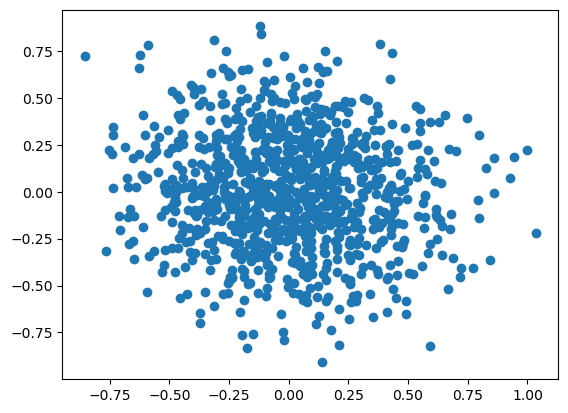

In [27]:
x, logp_diff_t1 = get_batch(600)
func(Tensor([1]).to(device),[x, logp_diff_t1])[0].size()

torch.Size([600, 2])

In [26]:
x.size()

torch.Size([96, 2])

In [14]:
logp_diff_t1.size()

torch.Size([2, 1])

In [ ]:
a = torch.rand(3,1,2)
# a.transpose()

a

tensor([[[0.7915, 0.1248]],

        [[0.5811, 0.5850]],

        [[0.0923, 0.7014]]])

In [ ]:
torch.matmul(a.transpose(1,2),a).size()


torch.Size([3, 2, 2])

Docstring:
mul(input, other, *, out=None) -> Tensor

Multiplies :attr:`input` by :attr:`other`.


.. math::
    \text{out}_i = \text{input}_i \times \text{other}_i


Supports :ref:`broadcasting to a common shape <broadcasting-semantics>`,
:ref:`type promotion <type-promotion-doc>`, and integer, float, and complex inputs.

Args:
    input (Tensor): the input tensor.
    other (Tensor or Number) - the tensor or number to multiply input by.

Keyword args:
    out (Tensor, optional): the output tensor.

Examples::

    >>> a = torch.randn(3)
    >>> a
    tensor([ 0.2015, -0.4255,  2.6087])
    >>> torch.mul(a, 100)
    tensor([  20.1494,  -42.5491,  260.8663])

    >>> b = torch.randn(4, 1)
    >>> b
    tensor([[ 1.1207],
            [-0.3137],
            [ 0.0700],
            [ 0.8378]])
    >>> c = torch.randn(1, 4)
    >>> c
    tensor([[ 0.5146,  0.1216, -0.5244,  2.2382]])
    >>> torch.mul(b, c)
    tensor([[ 0.5767,  0.1363, -0.5877,  2.5083],
            [-0.1614, -0.0382,  0.1